<a href="https://colab.research.google.com/github/Praneeth-18/Deep-Learning-6/blob/main/Part_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [42]:
!pip install tensorflow
!pip install keras-tuner --upgrade

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 3.2 MB/s eta 0:00:00


In [40]:
!pip install keras

In [1]:
import tensorflow as tf
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Sequential
from tensorflow.keras.regularizers import l1, l2
import matplotlib.pyplot as plt

In [3]:
input_dim = 20

def build_model(regularizer=None):
    model = Sequential([
        Dense(64, activation='relu', input_shape=(input_dim,), kernel_regularizer=regularizer),
        Dense(64, activation='relu', kernel_regularizer=regularizer),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Example of L1 regularization
model_l1 = build_model(regularizer=l1(0.01))

# Example of L2 regularization
model_l2 = build_model(regularizer=l2(0.01))


In [4]:
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split

X, y = make_classification(n_samples=1000, n_features=input_dim, n_classes=2, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

history_l1 = model_l1.fit(X_train, y_train, epochs=50, validation_split=0.2)
history_l2 = model_l2.fit(X_train, y_train, epochs=50, validation_split=0.2)

Epoch 1/50
20/20 [==============================] - 2s 30ms/step - loss: 6.5114 - accuracy: 0.5422 - val_loss: 5.9984 - val_accuracy: 0.6875
Epoch 2/50
20/20 [==============================] - 0s 4ms/step - loss: 5.5756 - accuracy: 0.7484 - val_loss: 5.1084 - val_accuracy: 0.8062
Epoch 3/50
20/20 [==============================] - 0s 4ms/step - loss: 4.7237 - accuracy: 0.8219 - val_loss: 4.2946 - val_accuracy: 0.8438
Epoch 4/50
20/20 [==============================] - 0s 4ms/step - loss: 3.9505 - accuracy: 0.8469 - val_loss: 3.5588 - val_accuracy: 0.8938
Epoch 5/50
20/20 [==============================] - 0s 4ms/step - loss: 3.2583 - accuracy: 0.8516 - val_loss: 2.9022 - val_accuracy: 0.8938
Epoch 6/50
20/20 [==============================] - 0s 4ms/step - loss: 2.6458 - accuracy: 0.8547 - val_loss: 2.3293 - val_accuracy: 0.9062
Epoch 7/50
20/20 [==============================] - 0s 4ms/step - loss: 2.1154 - accuracy: 0.8500 - val_loss: 1.8375 - val_accuracy: 0.9000
Epoch 8/50
20/20 [=

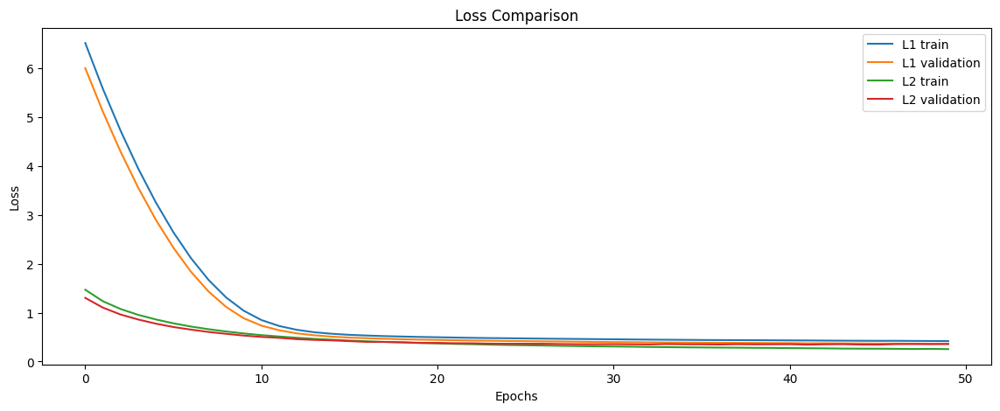

In [5]:
def plot_history(histories):
    plt.figure(figsize=(14, 5))
    for name, history in histories:
        plt.plot(history.history['loss'], label=f'{name} train')
        plt.plot(history.history['val_loss'], label=f'{name} validation')
    plt.title('Loss Comparison')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

plot_history([('L1', history_l1), ('L2', history_l2)])

---

In [6]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.models import Sequential
import matplotlib.pyplot as plt

In [7]:
def build_model_with_dropout(dropout_rate=0.5):
    model = Sequential([
        Dense(64, activation='relu', input_shape=(input_dim,)),
        Dropout(dropout_rate),
        Dense(64, activation='relu'),
        Dropout(dropout_rate),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

model_no_dropout = build_model_with_dropout(0.0)  # Control model with no dropout
model_with_dropout = build_model_with_dropout(0.5)  # Test model with 50% dropout

In [8]:
history_no_dropout = model_no_dropout.fit(X_train, y_train, epochs=50, validation_split=0.2)
history_with_dropout = model_with_dropout.fit(X_train, y_train, epochs=50, validation_split=0.2)

Epoch 1/50
20/20 [==============================] - 2s 12ms/step - loss: 0.6416 - accuracy: 0.6422 - val_loss: 0.5391 - val_accuracy: 0.8250
Epoch 2/50
20/20 [==============================] - 0s 4ms/step - loss: 0.5062 - accuracy: 0.8078 - val_loss: 0.4295 - val_accuracy: 0.8750
Epoch 3/50
20/20 [==============================] - 0s 4ms/step - loss: 0.4225 - accuracy: 0.8484 - val_loss: 0.3626 - val_accuracy: 0.8813
Epoch 4/50
20/20 [==============================] - 0s 5ms/step - loss: 0.3678 - accuracy: 0.8703 - val_loss: 0.3187 - val_accuracy: 0.8813
Epoch 5/50
20/20 [==============================] - 0s 6ms/step - loss: 0.3375 - accuracy: 0.8719 - val_loss: 0.2904 - val_accuracy: 0.8875
Epoch 6/50
20/20 [==============================] - 0s 5ms/step - loss: 0.3150 - accuracy: 0.8813 - val_loss: 0.2790 - val_accuracy: 0.8813
Epoch 7/50
20/20 [==============================] - 0s 6ms/step - loss: 0.2987 - accuracy: 0.8891 - val_loss: 0.2718 - val_accuracy: 0.8813
Epoch 8/50
20/20 [=

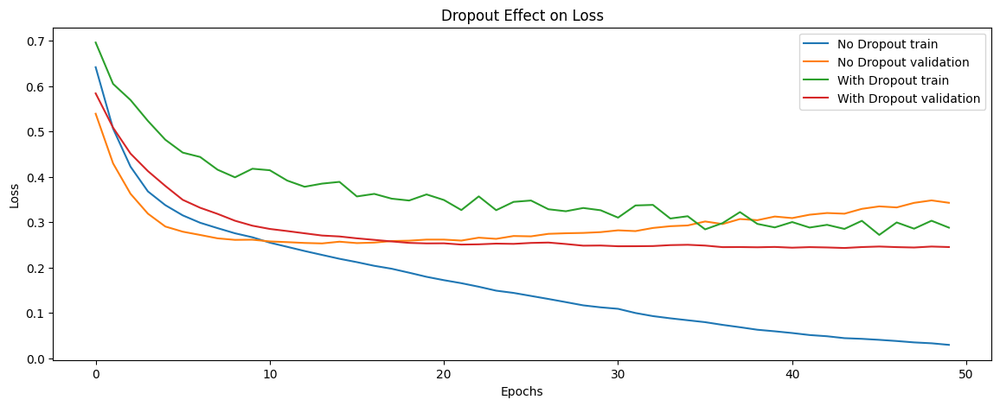

In [9]:
def plot_history(histories):
    plt.figure(figsize=(14, 5))
    for name, history in histories:
        plt.plot(history.history['loss'], label=f'{name} train')
        plt.plot(history.history['val_loss'], label=f'{name} validation')
    plt.title('Dropout Effect on Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

plot_history([
    ('No Dropout', history_no_dropout),
    ('With Dropout', history_with_dropout)
])

---

In [10]:
import tensorflow as tf
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt

In [11]:
def build_model():
    model = Sequential([
        Dense(64, activation='relu', input_shape=(input_dim,)),
        Dense(64, activation='relu'),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

model = build_model()

In [12]:
early_stopping_monitor = EarlyStopping(
    monitor='val_loss',
    patience=10,
    verbose=1,
    restore_best_weights=True
)

In [13]:
history = model.fit(
    X_train, y_train,
    epochs=100,
    validation_split=0.2,
    callbacks=[early_stopping_monitor]
)

Epoch 1/100
20/20 [==============================] - 1s 15ms/step - loss: 0.6044 - accuracy: 0.6906 - val_loss: 0.5012 - val_accuracy: 0.8188
Epoch 2/100
20/20 [==============================] - 0s 4ms/step - loss: 0.4547 - accuracy: 0.8250 - val_loss: 0.3974 - val_accuracy: 0.8438
Epoch 3/100
20/20 [==============================] - 0s 4ms/step - loss: 0.3771 - accuracy: 0.8641 - val_loss: 0.3323 - val_accuracy: 0.8875
Epoch 4/100
20/20 [==============================] - 0s 5ms/step - loss: 0.3354 - accuracy: 0.8766 - val_loss: 0.2974 - val_accuracy: 0.8875
Epoch 5/100
20/20 [==============================] - 0s 4ms/step - loss: 0.3122 - accuracy: 0.8906 - val_loss: 0.2763 - val_accuracy: 0.8875
Epoch 6/100
20/20 [==============================] - 0s 4ms/step - loss: 0.2981 - accuracy: 0.8875 - val_loss: 0.2677 - val_accuracy: 0.8938
Epoch 7/100
20/20 [==============================] - 0s 4ms/step - loss: 0.2839 - accuracy: 0.8984 - val_loss: 0.2562 - val_accuracy: 0.8813
Epoch 8/100


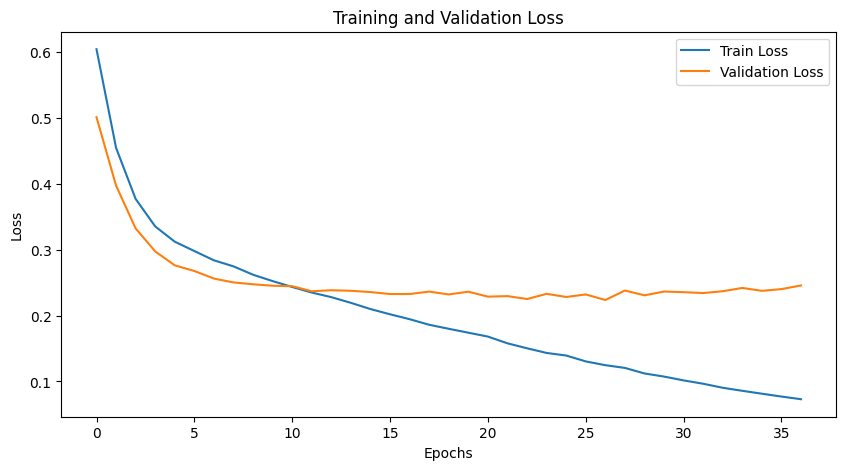

In [14]:
plt.figure(figsize=(10, 5))
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

---

In [15]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.models import Sequential
import numpy as np
import matplotlib.pyplot as plt

In [17]:
class MCDropout(tf.keras.layers.Dropout):
    def call(self, inputs, training=None):
        return super().call(inputs, training=True)  # Always apply dropout

def build_mc_dropout_model(dropout_rate=0.5):
    model = Sequential([
        Dense(64, activation='relu', input_shape=(input_dim,)),
        MCDropout(dropout_rate),  # Custom dropout always active
        Dense(64, activation='relu'),
        MCDropout(dropout_rate),  # Custom dropout always active
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

mc_dropout_model = build_mc_dropout_model(0.5)

In [18]:
def mc_dropout_predict(model, X, n_samples=100):
    predictions = [model.predict(X) for _ in range(n_samples)]
    return np.array(predictions)

X_sample = X_test[:5]
mc_predictions = mc_dropout_predict(mc_dropout_model, X_sample)

mean_predictions = np.mean(mc_predictions, axis=0)
std_predictions = np.std(mc_predictions, axis=0)

print("Mean Predictions:\n", mean_predictions)
print("Standard Deviations:\n", std_predictions)

1/1 [==============================] - 0s 24ms/step
Mean Predictions:
 [[0.49242452]
 [0.53624433]
 [0.54275936]
 [0.44421172]
 [0.40766025]]
Standard Deviations:
 [[0.1458193 ]
 [0.16799068]
 [0.22534168]
 [0.21744391]
 [0.20203738]]


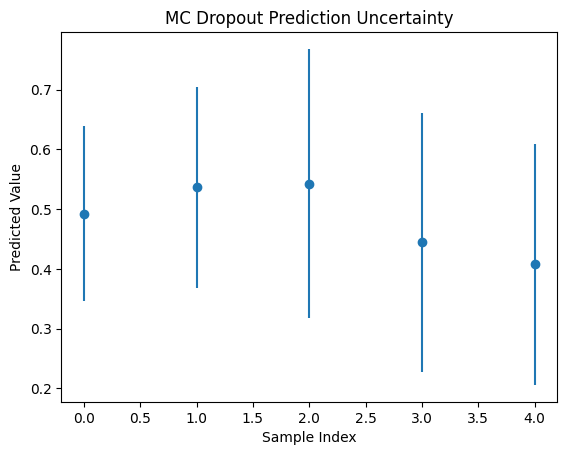

In [19]:
plt.errorbar(np.arange(len(X_sample)), mean_predictions.flatten(), yerr=std_predictions.flatten(), fmt='o')
plt.title('MC Dropout Prediction Uncertainty')
plt.xlabel('Sample Index')
plt.ylabel('Predicted Value')
plt.show()

---

In [20]:
import tensorflow as tf
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Sequential
from tensorflow.keras.initializers import RandomNormal, HeNormal, GlorotUniform
import matplotlib.pyplot as plt

In [21]:
def build_model(initializer):
    model = Sequential([
        Dense(64, activation='relu', input_shape=(input_dim,), kernel_initializer=initializer),
        Dense(64, activation='relu', kernel_initializer=initializer),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Different initializers
normal_initializer = RandomNormal(mean=0.0, stddev=0.05)
he_initializer = HeNormal()
glorot_initializer = GlorotUniform()

models = {
    "Random Normal": build_model(normal_initializer),
    "He Normal": build_model(he_initializer),
    "Glorot Uniform": build_model(glorot_initializer)
}

/usr/local/lib/python3.10/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer HeNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values each ti

In [22]:
history_dict = {}
for name, model in models.items():
    print(f"Training with {name} initializer")
    history = model.fit(X_train, y_train, epochs=50, validation_split=0.2)
    history_dict[name] = history

Training with Random Normal initializer
Epoch 1/50
20/20 [==============================] - 2s 20ms/step - loss: 0.6450 - accuracy: 0.7516 - val_loss: 0.5758 - val_accuracy: 0.8750
Epoch 2/50
20/20 [==============================] - 0s 4ms/step - loss: 0.5078 - accuracy: 0.8375 - val_loss: 0.4059 - val_accuracy: 0.8938
Epoch 3/50
20/20 [==============================] - 0s 4ms/step - loss: 0.3796 - accuracy: 0.8641 - val_loss: 0.2922 - val_accuracy: 0.8813
Epoch 4/50
20/20 [==============================] - 0s 4ms/step - loss: 0.3213 - accuracy: 0.8781 - val_loss: 0.2612 - val_accuracy: 0.8750
Epoch 5/50
20/20 [==============================] - 0s 4ms/step - loss: 0.3004 - accuracy: 0.8859 - val_loss: 0.2581 - val_accuracy: 0.8750
Epoch 6/50
20/20 [==============================] - 0s 5ms/step - loss: 0.2867 - accuracy: 0.8828 - val_loss: 0.2520 - val_accuracy: 0.8750
Epoch 7/50
20/20 [==============================] - 0s 4ms/step - loss: 0.2751 - accuracy: 0.8906 - val_loss: 0.2501 - 

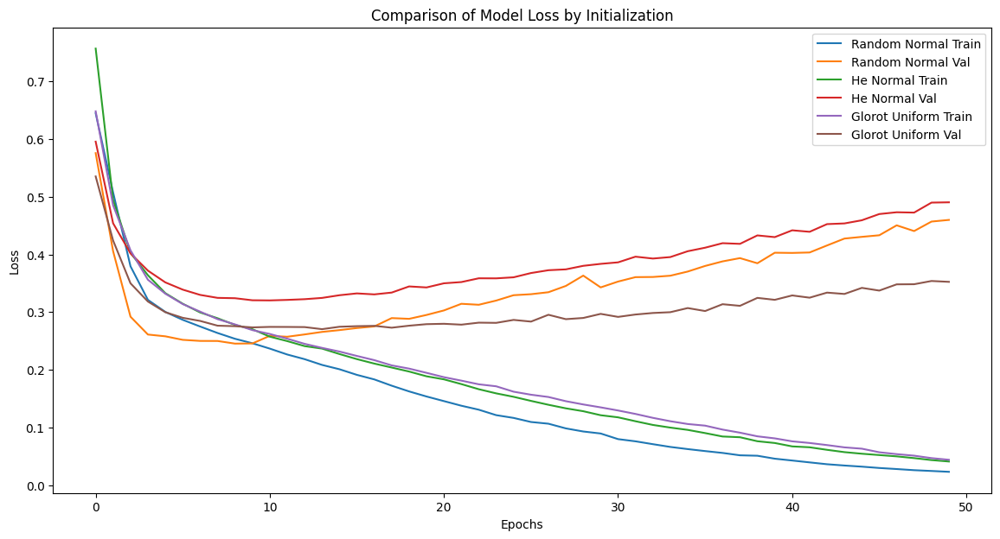

In [23]:
plt.figure(figsize=(14, 7))
for name, history in history_dict.items():
    plt.plot(history.history['loss'], label=f'{name} Train')
    plt.plot(history.history['val_loss'], label=f'{name} Val')
plt.title('Comparison of Model Loss by Initialization')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

---

In [24]:
import tensorflow as tf
from tensorflow.keras.layers import Dense, BatchNormalization, Activation
from tensorflow.keras.models import Sequential
import matplotlib.pyplot as plt

In [25]:
def build_model(use_batch_norm):
    model = Sequential()
    model.add(Dense(64, input_shape=(input_dim,)))
    if use_batch_norm:
        model.add(BatchNormalization())
    model.add(Activation('relu'))

    model.add(Dense(64))
    if use_batch_norm:
        model.add(BatchNormalization())
    model.add(Activation('relu'))

    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

model_without_bn = build_model(use_batch_norm=False)
model_with_bn = build_model(use_batch_norm=True)

In [26]:
history_no_bn = model_without_bn.fit(X_train, y_train, epochs=50, validation_split=0.2)
history_with_bn = model_with_bn.fit(X_train, y_train, epochs=50, validation_split=0.2)

Epoch 1/50
20/20 [==============================] - 1s 12ms/step - loss: 0.6514 - accuracy: 0.6266 - val_loss: 0.5586 - val_accuracy: 0.7250
Epoch 2/50
20/20 [==============================] - 0s 4ms/step - loss: 0.4956 - accuracy: 0.8031 - val_loss: 0.4358 - val_accuracy: 0.8188
Epoch 3/50
20/20 [==============================] - 0s 4ms/step - loss: 0.4123 - accuracy: 0.8438 - val_loss: 0.3573 - val_accuracy: 0.9000
Epoch 4/50
20/20 [==============================] - 0s 3ms/step - loss: 0.3594 - accuracy: 0.8609 - val_loss: 0.3118 - val_accuracy: 0.9062
Epoch 5/50
20/20 [==============================] - 0s 4ms/step - loss: 0.3287 - accuracy: 0.8750 - val_loss: 0.2834 - val_accuracy: 0.9062
Epoch 6/50
20/20 [==============================] - 0s 3ms/step - loss: 0.3078 - accuracy: 0.8813 - val_loss: 0.2694 - val_accuracy: 0.9062
Epoch 7/50
20/20 [==============================] - 0s 3ms/step - loss: 0.2939 - accuracy: 0.8859 - val_loss: 0.2629 - val_accuracy: 0.9000
Epoch 8/50
20/20 [=

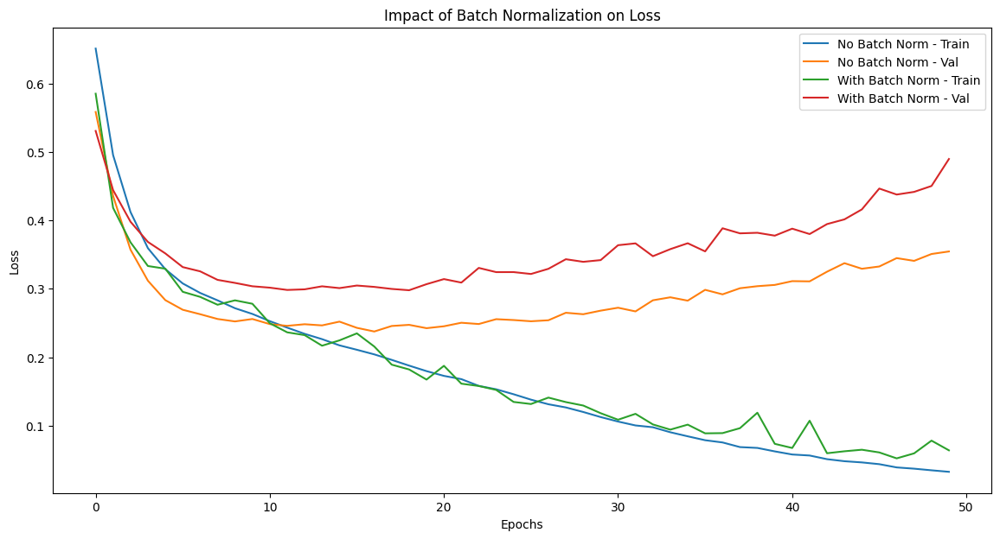

In [27]:
plt.figure(figsize=(14, 7))
plt.plot(history_no_bn.history['loss'], label='No Batch Norm - Train')
plt.plot(history_no_bn.history['val_loss'], label='No Batch Norm - Val')
plt.plot(history_with_bn.history['loss'], label='With Batch Norm - Train')
plt.plot(history_with_bn.history['val_loss'], label='With Batch Norm - Val')
plt.title('Impact of Batch Normalization on Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

----

In [28]:
import tensorflow as tf
from tensorflow.keras.layers import Layer, Dense
from tensorflow.keras.models import Sequential
import matplotlib.pyplot as plt

In [29]:
class SmartDropout(Layer):
    def __init__(self, rate, **kwargs):
        super(SmartDropout, self).__init__(**kwargs)
        self.rate = rate

    def call(self, inputs, training=None):
        if not training:
            return inputs
        noise_shape = (inputs.shape[0], 1) + inputs.shape[2:]
        return tf.nn.dropout(inputs, rate=self.rate, noise_shape=noise_shape)

def build_model_with_custom_dropout(dropout_rate=0.5):
    model = Sequential([
        Dense(64, activation='relu', input_shape=(input_dim,)),
        SmartDropout(dropout_rate),
        Dense(64, activation='relu'),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

model_custom_dropout = build_model_with_custom_dropout(0.3)

In [30]:
def l2_custom_regularizer(scale, target=0.5):
    def l2_regularizer(weight_matrix):
        return tf.reduce_sum(scale * tf.square(weight_matrix - target))
    return l2_regularizer

custom_regularizer = l2_custom_regularizer(0.01)

model_custom_reg = Sequential([
    Dense(64, activation='relu', input_shape=(input_dim,), kernel_regularizer=custom_regularizer),
    Dense(64, activation='relu', kernel_regularizer=custom_regularizer),
    Dense(1, activation='sigmoid')
])
model_custom_reg.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [31]:
history_custom_dropout = model_custom_dropout.fit(X_train, y_train, epochs=50, validation_split=0.2)
history_custom_reg = model_custom_reg.fit(X_train, y_train, epochs=50, validation_split=0.2)

Epoch 1/50
20/20 [==============================] - 2s 36ms/step - loss: 0.6814 - accuracy: 0.5562 - val_loss: 0.5663 - val_accuracy: 0.7937
Epoch 2/50
20/20 [==============================] - 0s 18ms/step - loss: 0.5591 - accuracy: 0.7297 - val_loss: 0.4569 - val_accuracy: 0.8813
Epoch 3/50
20/20 [==============================] - 0s 14ms/step - loss: 0.4837 - accuracy: 0.7609 - val_loss: 0.3879 - val_accuracy: 0.8813
Epoch 4/50
20/20 [==============================] - 0s 9ms/step - loss: 0.4684 - accuracy: 0.7328 - val_loss: 0.3407 - val_accuracy: 0.8687
Epoch 5/50
20/20 [==============================] - 0s 12ms/step - loss: 0.4472 - accuracy: 0.7453 - val_loss: 0.3201 - val_accuracy: 0.8625
Epoch 6/50
20/20 [==============================] - 0s 12ms/step - loss: 0.4045 - accuracy: 0.7672 - val_loss: 0.3112 - val_accuracy: 0.8562
Epoch 7/50
20/20 [==============================] - 0s 14ms/step - loss: 0.4180 - accuracy: 0.7859 - val_loss: 0.2935 - val_accuracy: 0.8750
Epoch 8/50
20/

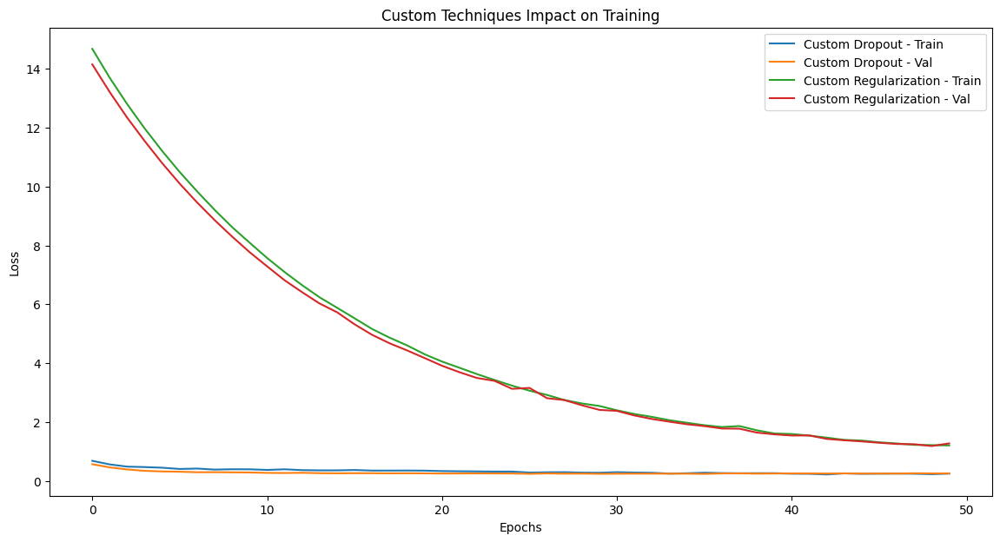

In [32]:
plt.figure(figsize=(14, 7))
plt.plot(history_custom_dropout.history['loss'], label='Custom Dropout - Train')
plt.plot(history_custom_dropout.history['val_loss'], label='Custom Dropout - Val')
plt.plot(history_custom_reg.history['loss'], label='Custom Regularization - Train')
plt.plot(history_custom_reg.history['val_loss'], label='Custom Regularization - Val')
plt.title('Custom Techniques Impact on Training')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

---

In [33]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard
from datetime import datetime
import os
import shutil
import numpy as np

# Clear any logs from previous runs
shutil.rmtree('/tmp/logs/', ignore_errors=True)

In [36]:
import numpy as np
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split

# Generate synthetic data
X, y = make_classification(n_samples=1000, n_features=20, n_informative=15, n_redundant=5, random_state=42)
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)
input_dim = X_train.shape[1]  # Number of features

In [34]:
def create_model(use_dropout=False, use_batch_norm=False):
    model = Sequential([
        Dense(64, activation='relu', input_shape=(input_dim,)),
        (Dropout(0.5) if use_dropout else tf.keras.layers.Lambda(lambda x: x)),
        (BatchNormalization() if use_batch_norm else tf.keras.layers.Lambda(lambda x: x)),
        Dense(64, activation='relu'),
        Dense(1, activation='sigmoid')
    ])
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

In [37]:
# Setup checkpoint directory
checkpoint_cb = ModelCheckpoint("/tmp/my_checkpoints", save_weights_only=True)

# Setup early stopping
early_stopping_cb = EarlyStopping(patience=10, restore_best_weights=True)

# Setup TensorBoard
log_dir = "/tmp/logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_cb = TensorBoard(log_dir=log_dir, histogram_freq=1)

# Train the model
model = create_model(use_dropout=True, use_batch_norm=True)
history = model.fit(X_train, y_train, epochs=100,
                    validation_data=(X_valid, y_valid),
                    callbacks=[checkpoint_cb, early_stopping_cb, tensorboard_cb])

Epoch 1/100
25/25 [==============================] - 4s 49ms/step - loss: 0.7453 - accuracy: 0.5475 - val_loss: 0.6167 - val_accuracy: 0.6650
Epoch 2/100
25/25 [==============================] - 1s 26ms/step - loss: 0.6127 - accuracy: 0.6712 - val_loss: 0.5042 - val_accuracy: 0.7850
Epoch 3/100
25/25 [==============================] - 1s 21ms/step - loss: 0.5226 - accuracy: 0.7412 - val_loss: 0.4256 - val_accuracy: 0.8500
Epoch 4/100
25/25 [==============================] - 1s 25ms/step - loss: 0.5118 - accuracy: 0.7387 - val_loss: 0.3844 - val_accuracy: 0.8600
Epoch 5/100
25/25 [==============================] - 1s 22ms/step - loss: 0.4427 - accuracy: 0.8087 - val_loss: 0.3521 - val_accuracy: 0.8850
Epoch 6/100
25/25 [==============================] - 1s 25ms/step - loss: 0.4147 - accuracy: 0.8138 - val_loss: 0.3229 - val_accuracy: 0.8850
Epoch 7/100
25/25 [==============================] - 1s 24ms/step - loss: 0.4083 - accuracy: 0.8100 - val_loss: 0.3008 - val_accuracy: 0.8900
Epoch 

In [38]:
# Load TensorBoard within the notebook
%load_ext tensorboard
%tensorboard --logdir /tmp/logs/fit

<IPython.core.display.Javascript object>

---

In [3]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.datasets import mnist
import numpy as np
import matplotlib.pyplot as plt
import keras_tuner as kt

# Load the dataset
(X_train_full, y_train_full), (X_test, y_test) = mnist.load_data()

# Normalize and split the dataset
X_valid, X_train = X_train_full[:5000] / 255.0, X_train_full[5000:] / 255.0
y_valid, y_train = y_train_full[:5000], y_train_full[5000:]

11490434/11490434 [==============================] - 0s 0us/step


In [4]:
def build_model(hp):
    model = keras.models.Sequential([
        keras.layers.Flatten(input_shape=[28, 28]),
        keras.layers.Dense(
            units=hp.Int('units', min_value=100, max_value=500, step=50),
            activation='relu'),
        keras.layers.Dense(10, activation='softmax')
    ])
    optimizer = keras.optimizers.SGD(
        learning_rate=hp.Float('learning_rate', min_value=1e-4, max_value=1e-2, sampling='log'))
    model.compile(optimizer=optimizer,
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])
    return model

In [5]:
tuner = kt.RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=5,
    executions_per_trial=3,
    directory='my_mnist_dir',
    project_name='mnist_tuning')

tuner.search(X_train, y_train, epochs=10, validation_data=(X_valid, y_valid))

Trial 5 Complete [00h 03m 48s]
val_accuracy: 0.8600666522979736

Best val_accuracy So Far: 0.9201333125432333
Total elapsed time: 00h 19m 02s


In [6]:
best_model = tuner.get_best_models(num_models=1)[0]
best_model.evaluate(X_test, y_test)

313/313 [==============================] - 1s 2ms/step - loss: 34.7148 - accuracy: 0.9149


[34.71481704711914, 0.914900004863739]

In [7]:
callbacks = [
    tf.keras.callbacks.EarlyStopping(patience=10),
    tf.keras.callbacks.ModelCheckpoint("mnist_model.h5", save_best_only=True),
    tf.keras.callbacks.TensorBoard(log_dir="./mnist_logs")
]

# Retrain and validate with the best hyperparameters
model = build_model(tuner.get_best_hyperparameters()[0])
history = model.fit(
    X_train, y_train, epochs=50, validation_data=(X_valid, y_valid),
    callbacks=callbacks)

# Start TensorBoard within the notebook
%load_ext tensorboard
%tensorboard --logdir=./mnist_logs

Epoch 1/50
1719/1719 [==============================] - 7s 4ms/step - loss: 1.3055 - accuracy: 0.6828 - val_loss: 0.7671 - val_accuracy: 0.8256
Epoch 2/50
  49/1719 [..............................] - ETA: 5s - loss: 0.7587 - accuracy: 0.8355

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1719/1719 [==============================] - 6s 4ms/step - loss: 0.6393 - accuracy: 0.8483 - val_loss: 0.5295 - val_accuracy: 0.8676
Epoch 3/50
1719/1719 [==============================] - 6s 4ms/step - loss: 0.4982 - accuracy: 0.8726 - val_loss: 0.4424 - val_accuracy: 0.8816
Epoch 4/50
1719/1719 [==============================] - 6s 4ms/step - loss: 0.4356 - accuracy: 0.8845 - val_loss: 0.3962 - val_accuracy: 0.8908
Epoch 5/50
1719/1719 [==============================] - 6s 4ms/step - loss: 0.3989 - accuracy: 0.8924 - val_loss: 0.3678 - val_accuracy: 0.8982
Epoch 6/50
1719/1719 [==============================] - 7s 4ms/step - loss: 0.3739 - accuracy: 0.8973 - val_loss: 0.3460 - val_accuracy: 0.9052
Epoch 7/50
1719/1719 [==============================] - 6s 4ms/step - loss: 0.3553 - accuracy: 0.9015 - val_loss: 0.3296 - val_accuracy: 0.9108
Epoch 8/50
1719/1719 [==============================] - 6s 4ms/step - loss: 0.3405 - accuracy: 0.9051 - val_loss: 0.3168 - val_accuracy: 0.9144
Epo

<IPython.core.display.Javascript object>

---

# **This task requires GPU only**

In [2]:
!pip install keras-cv
!pip install tensorflow-datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 613.1/613.1 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 950.8/950.8 kB 16.2 MB/s eta 0:00:00


In [3]:
import os
os.environ["KERAS_BACKEND"] = "tensorflow"

import tensorflow as tf
import keras_cv
import tensorflow_datasets as tfds
import keras

# Assuming images are scaled from 0 to 255
BATCH_SIZE = 16
NUM_CLASSES = 3
augmenter = keras_cv.layers.Augmenter(
    [
        keras_cv.layers.RandomFlip(),
        keras_cv.layers.RandAugment(value_range=(0, 255)),
        keras_cv.layers.CutMix(),
        keras_cv.layers.RandomRotation(factor=0.10),
        keras_cv.layers.RandomTranslation(height_factor=0.1, width_factor=0.1),
        keras_cv.layers.RandomContrast(factor=0.10, value_range=(0, 255))  # Corrected line
    ],
)

Using TensorFlow backend


In [4]:
def preprocess_data(images, labels, augment=False):
    labels = tf.one_hot(labels, NUM_CLASSES)
    inputs = {"images": images, "labels": labels}
    outputs = inputs
    if augment:
        outputs = augmenter(outputs)
    return outputs['images'], outputs['labels']

train_dataset, test_dataset = tfds.load(
    'rock_paper_scissors',
    as_supervised=True,
    split=['train', 'test'],
)
train_dataset = train_dataset.batch(BATCH_SIZE).map(
    lambda x, y: preprocess_data(x, y, augment=True),
    num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)
test_dataset = test_dataset.batch(BATCH_SIZE).map(
    preprocess_data, num_parallel_calls=tf.data.AUTOTUNE).prefetch(tf.data.AUTOTUNE)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/2520 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/rock_paper_scissors/3.0.0.incompleteNLCTDO/rock_paper_scissors-train.tfrec…

Generating test examples...:   0%|          | 0/372 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/rock_paper_scissors/3.0.0.incompleteNLCTDO/rock_paper_scissors-test.tfreco…

Dataset rock_paper_scissors downloaded and prepared to /root/tensorflow_datasets/rock_paper_scissors/3.0.0. Subsequent calls will reuse this data.


In [6]:
# Create a model using a pretrained backbone
backbone = keras_cv.models.EfficientNetV2Backbone.from_preset("efficientnetv2_b0_imagenet")
model = keras_cv.models.ImageClassifier(
    backbone=backbone,
    num_classes=NUM_CLASSES,
    activation="softmax",
)
model.compile(
    loss='categorical_crossentropy',
    optimizer=keras.optimizers.Adam(learning_rate=1e-5),
    metrics=['accuracy']
)

# Train the model
model.fit(
    train_dataset,
    validation_data=test_dataset,
    epochs=5,
)

100%|██████████| 23.1M/23.1M [00:01<00:00, 21.7MB/s]
/usr/local/lib/python3.10/dist-packages/keras_cv/src/models/backbones/backbone.py:44: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  return id(getattr(self, attr)) not in self._functional_layer_ids
/usr/local/lib/python3.10/dist-packages/keras_cv/src/models/backbones/backbone.py:44: UserWarning: `layer.updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  return id(getattr(self, attr)) not in self._functional_layer_ids


Epoch 1/5
158/158 [==============================] - 67s 127ms/step - loss: 1.1036 - accuracy: 0.3456 - val_loss: 1.0744 - val_accuracy: 0.5699
Epoch 2/5
158/158 [==============================] - 18s 109ms/step - loss: 1.0791 - accuracy: 0.4353 - val_loss: 1.0155 - val_accuracy: 0.6720
Epoch 3/5
158/158 [==============================] - 18s 105ms/step - loss: 1.0596 - accuracy: 0.4829 - val_loss: 0.9443 - val_accuracy: 0.7769
Epoch 4/5
158/158 [==============================] - 18s 105ms/step - loss: 1.0298 - accuracy: 0.5488 - val_loss: 0.8608 - val_accuracy: 0.8468
Epoch 5/5
158/158 [==============================] - 18s 106ms/step - loss: 0.9953 - accuracy: 0.5972 - val_loss: 0.7594 - val_accuracy: 0.8710


In [7]:
test_loss, test_accuracy = model.evaluate(test_dataset)
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

24/24 [==============================] - 0s 18ms/step - loss: 0.7594 - accuracy: 0.8710
Test Loss: 0.7593588829040527
Test Accuracy: 0.8709677457809448


1/1 [==============================] - 2s 2s/step


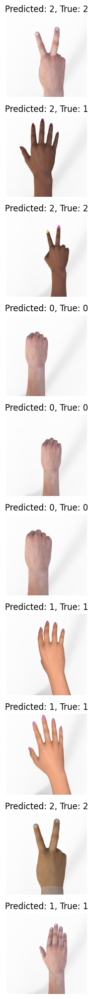

In [8]:
import matplotlib.pyplot as plt

def display_sample_predictions(dataset, num_samples=10):
    plt.figure(figsize=(12, num_samples * 2))
    for images, labels in dataset.take(1):
        predictions = model.predict(images)
        predictions = tf.argmax(predictions, axis=1)
        labels = tf.argmax(labels, axis=1)
        for i in range(num_samples):
            plt.subplot(num_samples, 2, 2 * i + 1)
            plt.imshow(images[i].numpy().astype("uint8"), cmap="gray")
            plt.title("Predicted: {}, True: {}".format(predictions[i], labels[i]))
            plt.axis("off")
    plt.tight_layout()
    plt.show()

# Assuming the test dataset yields batches of (images, labels)
display_sample_predictions(test_dataset)

1/1 [==============================] - 0s 27ms/step


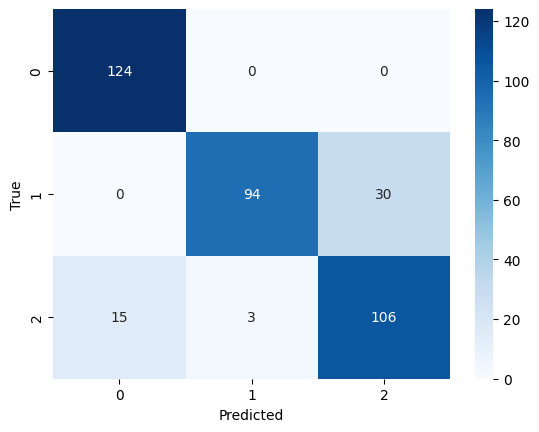

In [9]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

def plot_confusion_matrix(dataset):
    all_labels = []
    all_predictions = []
    for images, labels in dataset:
        preds = model.predict(images)
        preds = tf.argmax(preds, axis=1)
        all_predictions.extend(preds.numpy())
        labels = tf.argmax(labels, axis=1)
        all_labels.extend(labels.numpy())

    cm = confusion_matrix(all_labels, all_predictions)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=range(NUM_CLASSES), yticklabels=range(NUM_CLASSES))
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

plot_confusion_matrix(test_dataset)

Epoch 1/8
158/158 [==============================] - 18s 107ms/step - loss: 0.9674 - accuracy: 0.6127 - val_loss: 0.6487 - val_accuracy: 0.9140
Epoch 2/8
158/158 [==============================] - 18s 107ms/step - loss: 0.9337 - accuracy: 0.6401 - val_loss: 0.5681 - val_accuracy: 0.9220
Epoch 3/8
158/158 [==============================] - 18s 106ms/step - loss: 0.8964 - accuracy: 0.6619 - val_loss: 0.4997 - val_accuracy: 0.9731
Epoch 4/8
158/158 [==============================] - 18s 107ms/step - loss: 0.8670 - accuracy: 0.6873 - val_loss: 0.4058 - val_accuracy: 0.9812
Epoch 5/8
158/158 [==============================] - 18s 107ms/step - loss: 0.8509 - accuracy: 0.6813 - val_loss: 0.3608 - val_accuracy: 0.9919
Epoch 6/8
158/158 [==============================] - 18s 108ms/step - loss: 0.8336 - accuracy: 0.6798 - val_loss: 0.3348 - val_accuracy: 0.9973
Epoch 7/8
158/158 [==============================] - 18s 107ms/step - loss: 0.8148 - accuracy: 0.7004 - val_loss: 0.3044 - val_accuracy:

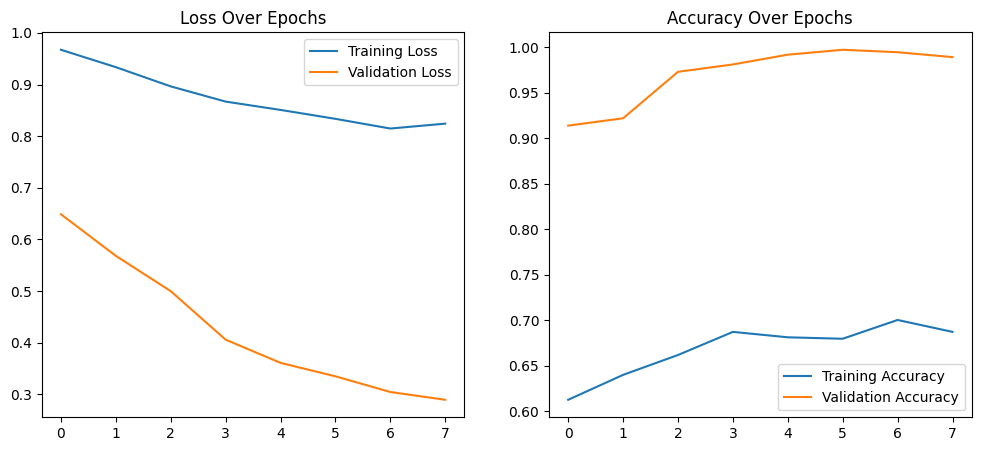

In [11]:
history = model.fit(
    train_dataset,
    validation_data=test_dataset,
    epochs=8
)

# Plotting the training history
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.title('Loss Over Epochs')

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend()
plt.title('Accuracy Over Epochs')
plt.show()

---

# **AugLy**

# **IMAGE**

In [1]:
!pip install augly[image]
!pip install tensorflow tensorflow-datasets
!sudo apt-get install python3-magic

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
python3-magic is already the newest version (2:0.4.24-2).
0 upgraded, 0 newly installed, 0 to remove and 45 not upgraded.


In [3]:
import os
import augly.image as imaugs
import augly.utils as utils
import tensorflow_datasets as tfds
from IPython.display import display
import numpy as np

# Load CIFAR-10 data
(ds_train, ds_test), ds_info = tfds.load(
    'cifar10',
    split=['train', 'test'],
    shuffle_files=True,
    as_supervised=True,
    with_info=True,
)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/50000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/cifar10/3.0.2.incompleteCPIWJR/cifar10-train.tfrecord*...:   0%|          …

Generating test examples...:   0%|          | 0/10000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/cifar10/3.0.2.incompleteCPIWJR/cifar10-test.tfrecord*...:   0%|          |…

Dataset cifar10 downloaded and prepared to /root/tensorflow_datasets/cifar10/3.0.2. Subsequent calls will reuse this data.


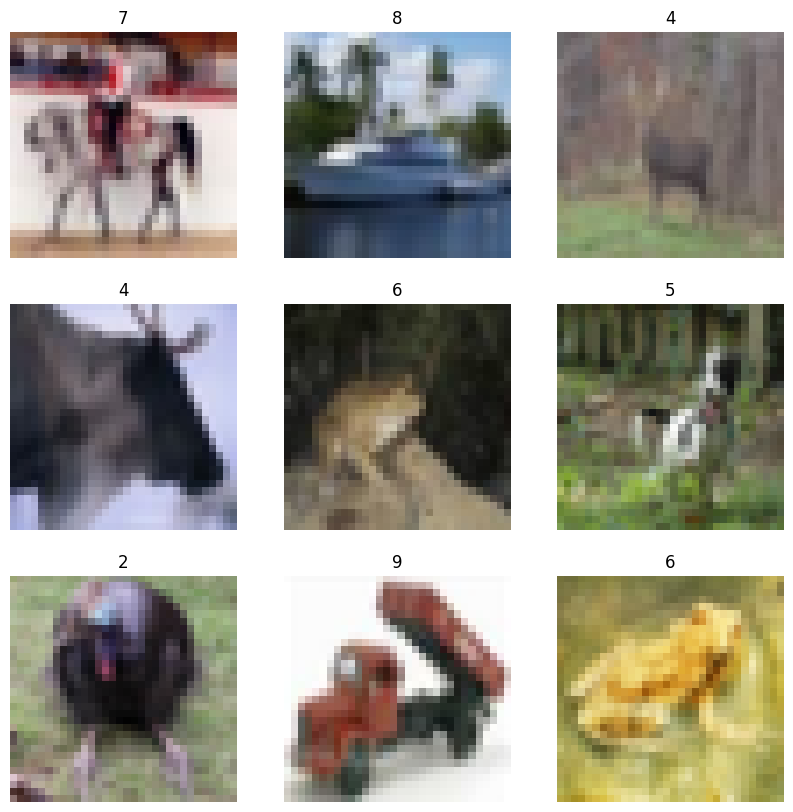

In [5]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt

# Define the preprocess_image function
def preprocess_image(image, label):
    image = tf.image.convert_image_dtype(image, tf.float32)
    image = tf.image.resize(image, [32, 32])
    return image, label

# Load and preprocess the dataset
ds_train, ds_test = tfds.load(
    'cifar10',
    split=['train[:10%]', 'test[:10%]'],  # Only load a small subset for efficiency
    as_supervised=True
)

# Prepare and batch the datasets
batch_size = 16
ds_train = ds_train.map(preprocess_image).batch(batch_size).prefetch(tf.data.experimental.AUTOTUNE)
ds_test = ds_test.map(preprocess_image).batch(batch_size).prefetch(tf.data.experimental.AUTOTUNE)

# Example: Display a batch of images
for images, labels in ds_train.take(1):  # Taking only one batch
    plt.figure(figsize=(10, 10))
    for i in range(9):  # Displaying 9 images from the batch
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i])
        plt.title(int(labels[i]))
        plt.axis("off")
    plt.show()


# **VIDEO**

In [11]:
!pip install -U augly[video]
!sudo apt-get install python3-magic
!sudo add-apt-repository ppa:jonathonf/ffmpeg-4
!apt install ffmpeg

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.0/116.0 kB 2.0 MB/s eta 0:00:00
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
python3-magic is already the newest version (2:0.4.24-2).
0 upgraded, 0 newly installed, 0 to remove and 45 not upgraded.
Repository: 'deb https://ppa.launchpadcontent.net/jonathonf/ffmpeg-4/ubuntu/ jammy main'
Description:
Backport of FFmpeg 4 and associated libraries. Now includes AOM/AV1 support!

FDK AAC is not compatible with GPL and FFmpeg can't be redistributed with it included. Please don't ask for it to be added to this public PPA.

---

PPA supporters:

BigBlueButton (https://bigbluebutton.org)

---

Donate to FFMPEG: https://ffmpeg.org/donations.html
Donate to Debian: https://www.debian.org/donations
Donate to this PPA: https://ko-fi.com/jonathonf
More info: https://launchpad.net/~jonathonf/+archive/ubuntu/ffmpeg-4
Adding repository.
Press [ENTER] to continue or Ctrl-c to cancel.
Adding deb entry to

In [20]:
import augly.video as vidaugs

In [27]:
# Clear all previously imported modules (useful in Jupyter/Colab notebooks)
%reset -f

In [28]:
!pip install -U augly

In [31]:

from IPython.display import HTML, display
from base64 import b64encode
from google.colab import files

# Function to display video in the notebook
def display_video(path):
    mp4 = open(path, "rb").read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    display(HTML(f"""
        <video width=400 controls>
            <source src="{data_url}" type="video/mp4">
        </video>
    """))

# Upload a video file
print("Please upload a video file...")
uploaded = files.upload()
input_vid_path = next(iter(uploaded))
print(f"Uploaded video filename: {input_vid_path}")

# Define the path for the output video
out_vid_path = "/tmp/trimmed_video.mp4"

# Use FFmpeg to trim the video to the first 3 seconds
!ffmpeg -i "$input_vid_path" -ss 00:00:00 -to 00:00:03 -c copy "$out_vid_path" -y

# Display the trimmed video
display_video(out_vid_path)


Please upload a video file...


Saving 3064220-hd_1920_1080_24fps.mp4 to 3064220-hd_1920_1080_24fps (10).mp4
Uploaded video filename: 3064220-hd_1920_1080_24fps (10).mp4
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-lib

# **TEXT**

In [32]:
!pip install -U augly[text]
!sudo apt-get install python3-magic

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 394.2/394.2 kB 3.3 MB/s eta 0:00:00
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
python3-magic is already the newest version (2:0.4.24-2).
0 upgraded, 0 newly installed, 0 to remove and 50 not upgraded.


In [33]:
import augly.text as textaugs

# Define the input text
input_text = "Hello, world! How are you today?"
print("Original Text:", input_text)

# Apply typo simulation augmentation
print("Simulated Typos:", textaugs.simulate_typos(input_text))

# Apply replace with fun fonts augmentation
meta = []  # Initialize metadata list
fun_fonts_text = textaugs.replace_fun_fonts(
    input_text, vary_fonts=True, granularity="word", metadata=meta
)
print("Replaced with Fun Fonts:", fun_fonts_text)
print("Metadata for Fun Fonts:", meta)

# Replace similar Unicode characters augmentation
meta = []  # Reset metadata list for a new augmentation
aug = textaugs.ReplaceSimilarUnicodeChars(aug_word_p=0.6)
unicode_replaced_text = aug(input_text, metadata=meta)
print("Replaced Similar Unicode Chars:", unicode_replaced_text)
print("Metadata for Unicode Replacement:", meta)

# Swap gendered words in text
gendered_text = "She has two brothers, but she always wanted a sister."
aug = textaugs.SwapGenderedWords(aug_word_p=1.0)
gender_swapped_text = aug(gendered_text)
print("Gender-Swapped Text:", gender_swapped_text)

# Apply contractions to the text
aug = textaugs.Contractions(aug_p=1.0)
contracted_text = aug(input_text)
print("Text with Contractions:", contracted_text)


Original Text: Hello, world! How are you today?
Simulated Typos: Hello, world! Hodw pare you today?
Replaced with Fun Fonts: 𝐇𝐞𝐥𝐥𝐨, world! ℌ𝔬𝔴 are you today?
Metadata for Fun Fonts: [{'name': 'replace_fun_fonts', 'input_type': 'string', 'src_length': 1, 'dst_length': 32, 'aug_p': 0.3, 'aug_min': 1, 'aug_max': 10000, 'granularity': 'word', 'vary_fonts': True, 'fonts_path': '/usr/local/lib/python3.10/dist-packages/augly/assets/text/fun_fonts.json', 'n': 1, 'priority_words': None, 'intensity': 30.0}]
Replaced Similar Unicode Chars: Hέllo, woℝld! HoẂ are yoỮ todåy?
Metadata for Unicode Replacement: [{'name': 'replace_similar_unicode_chars', 'input_type': 'string', 'src_length': 1, 'dst_length': 32, 'aug_char_p': 0.3, 'aug_word_p': 0.6, 'min_char': 2, 'aug_char_min': 1, 'aug_char_max': 1000, 'aug_word_min': 1, 'aug_word_max': 1000, 'n': 1, 'mapping_path': '/usr/local/lib/python3.10/dist-packages/augly/assets/text/letter_unicode_mapping.json', 'priority_words': None, 'intensity': 18.0}]
Gend

---

# **AUDIO**

In [34]:
!pip install -U augly[audio]
!sudo apt-get install python3-magic

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
python3-magic is already the newest version (2:0.4.24-2).
0 upgraded, 0 newly installed, 0 to remove and 50 not upgraded.


In [40]:
from google.colab import files
from IPython.display import Audio, display
import augly.audio as audaugs

# Upload the audio file
print("Please upload an audio file...")
uploaded = files.upload()
input_audio = next(iter(uploaded))  # Get the name of the uploaded file
print(f"Uploaded audio filename: {input_audio}")

# Display the original audio file
display(Audio(input_audio))

# Augment and display augmented audio
aug_audio, sr = audaugs.pitch_shift(input_audio, n_steps=4.0)
display(Audio(data=aug_audio, rate=sr))

input_audio_arr, sr = validate_and_load_audio(input_audio)

meta = []

try:
    # Trying the Peaking Equalizer augmentation again
    aug = audaugs.PeakingEqualizer()
    aug_audio, sr = aug(input_audio_arr, sample_rate=sr, metadata=meta)
    display(Audio(data=aug_audio, rate=sr))
    print("Metadata for Peaking Equalizer:", meta)
except Exception as e:
    print(f"Failed to apply audio augmentation: {str(e)}")

Please upload an audio file...


Saving Whistler Waves.mp3 to Whistler Waves (1).mp3
Uploaded audio filename: Whistler Waves (1).mp3


Metadata for Peaking Equalizer: [{'name': 'peaking_equalizer', 'src_duration': 53.733877551020406, 'dst_duration': 53.733877551020406, 'src_num_channels': 2, 'dst_num_channels': 2, 'src_sample_rate': 44100, 'dst_sample_rate': 44100, 'src_segments': [{'start': 0.0, 'end': 53.733877551020406}], 'dst_segments': [{'start': 0.0, 'end': 53.733877551020406}], 'center_hz': 500.0, 'q': 1.0, 'gain_db': -3.0, 'output_path': None, 'intensity': 2.66798418972332}]


---

# **FastAI**

In [41]:
from fastai.vision.all import *
path = untar_data(URLs.IMAGENETTE)

In [46]:
import multiprocessing as mp
mp.set_start_method('spawn', force=True)


In [50]:
from fastai.vision.all import *

# Set multiprocessing start method to 'spawn' to avoid compatibility issues
import multiprocessing as mp
mp.set_start_method('spawn', force=True)

# Load data
path = untar_data(URLs.IMAGENETTE)

# Define DataBlock with augmentation and normalization
def get_dls(bs, size):
    dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   get_y=parent_label,
                   item_tfms=Resize(460),
                   batch_tfms=[*aug_transforms(size=size, min_scale=0.75),
                               Normalize.from_stats(*imagenet_stats)])
    return dblock.dataloaders(path, bs=bs, num_workers=4)  # Increase num_workers for better data loading efficiency

# Create DataLoaders
dls = get_dls(64, 224)

# Define and train model
model = xresnet50(n_out=dls.c)
learn = Learner(dls, model, loss_func=CrossEntropyLossFlat(), metrics=accuracy)
learn.fit_one_cycle(1, 3e-3)


epoch,train_loss,valid_loss,accuracy,time


AttributeError: module '__main__' has no attribute '__spec__'

In [45]:
# Setup and import necessary libraries
from fastai.vision.all import *

# Ensure CUDA is available for GPU acceleration
print("CUDA available:", torch.cuda.is_available())

# Load and prepare the dataset
path = untar_data(URLs.IMAGENETTE)
def get_dls(bs, size, num_workers=4):
    dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                       get_items=get_image_files,
                       get_y=parent_label,
                       splitter=RandomSplitter(valid_pct=0.2, seed=42),
                       item_tfms=Resize(460),
                       batch_tfms=[*aug_transforms(size=size, min_scale=0.75),
                                   Normalize.from_stats(*imagenet_stats)])
    return dblock.dataloaders(path, bs=bs, num_workers=num_workers)

# Initialize DataLoaders
dls = get_dls(64, 224)

# Define the model
model = xresnet50(n_out=dls.c)
learn = Learner(dls, model, loss_func=CrossEntropyLossFlat(), metrics=accuracy)

# Start training the model
learn.fit_one_cycle(5, 3e-3)

# Print the training results
learn.recorder.plot_loss()

# Evaluate the model on a validation set
val_loss, val_acc = learn.validate()
print(f"Validation Loss: {val_loss}, Validation Accuracy: {val_acc}")

# Optionally, show a batch of data to visualize augmentations
dls.show_batch(max_n=4, unique=True)

CUDA available: False


epoch,train_loss,valid_loss,accuracy,time


AttributeError: module '__main__' has no attribute '__spec__'

epoch,train_loss,valid_loss,accuracy,time
0,2.255369,2.292868,0.157954,25:31


Validation Loss: 2.2928683757781982, Validation Accuracy: 0.1580


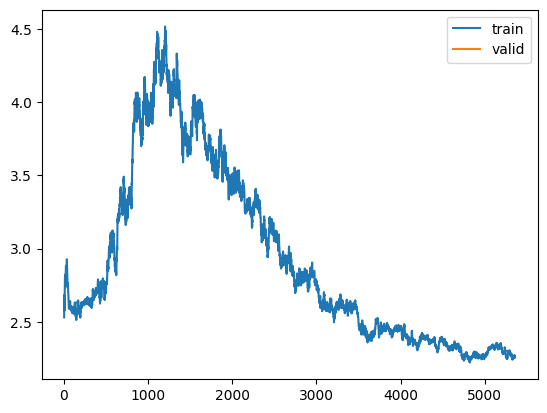

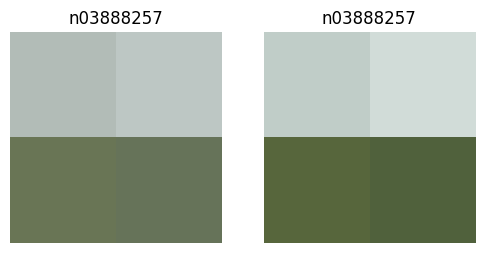

In [53]:
# Import necessary libraries
from fastai.vision.all import *

# Function to setup data loaders with reduced multiprocessing load
def get_dls(bs, size):
    dblock = DataBlock(
        blocks=(ImageBlock, CategoryBlock),
        get_items=get_image_files,
        splitter=RandomSplitter(valid_pct=0.2, seed=42),
        get_y=parent_label,
        item_tfms=Resize(460),
        batch_tfms=[*aug_transforms(size=size, min_scale=0.75), Normalize.from_stats(*imagenet_stats)]
    )
    return dblock.dataloaders(path, bs=bs, num_workers=0)  # Set num_workers to 0 to avoid multiprocessing issues

# Load and prepare the dataset
path = untar_data(URLs.IMAGENETTE)
dls = get_dls(2, 2)

# Define and train the model
model = xresnet50(n_out=dls.c)
learn = Learner(dls, model, loss_func=CrossEntropyLossFlat(), metrics=accuracy)
learn.fit_one_cycle(1, 3e-3)

# Evaluate the model on the validation set and print results
learn.recorder.plot_loss()
val_loss, val_acc = learn.validate()
print(f"Validation Loss: {val_loss}, Validation Accuracy: {val_acc:.4f}")

# Show a batch of data to visualize augmentations
dls.show_batch(max_n=4, unique=True)


In [54]:
 def get_dls(bs, size):
    dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                       get_items=get_image_files,
                       get_y=parent_label,
                       item_tfms=Resize(460),
                       batch_tfms=[*aug_transforms(size=size, min_scale=0.75),
                                   Normalize.from_stats(*imagenet_stats)])
    return dblock.dataloaders(path, bs=bs)


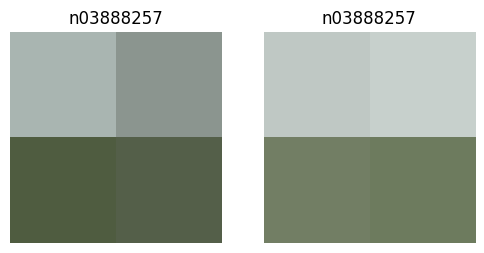

In [57]:
# Load one batch of images
x, y = dls.train.one_batch()

# Show a batch with augmentation applied
dls.show_batch(max_n=4, unique=True)